In [20]:
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import os
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import mannwhitneyu
import scipy.sparse as sp


In [21]:
sc.set_figure_params(dpi=150)

In [22]:
bdata_sig=sc.read_h5ad('/Users/anuvindpramod/Desktop/code/Sc_RNA_seq /bdata_sig.h5ad')

In [23]:
sc.pp.normalize_total(bdata_sig,target_sum=1e6)
sc.pp.log1p(bdata_sig)


YAP1 expression range: 0.0 to 7.1849260330200195


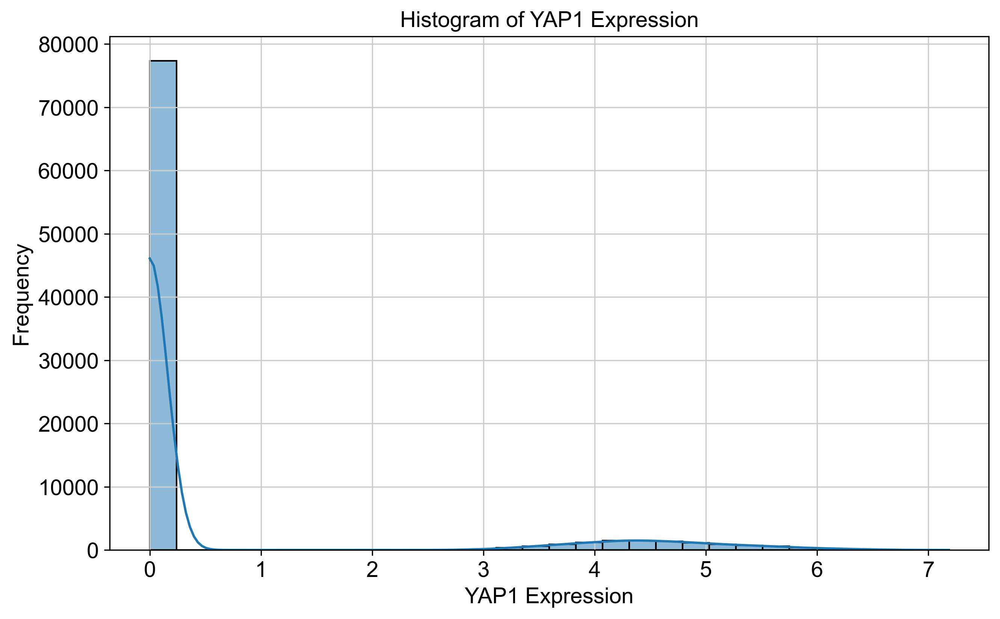

In [24]:
# YAP1 expression data
yap1_expression = bdata_sig[:, 'YAP1'].X.toarray().flatten()

# range of YAP1 expression
yap1_min = yap1_expression.min()
yap1_max = yap1_expression.max()
print(f"YAP1 expression range: {yap1_min} to {yap1_max}")


plt.figure(figsize=(10, 6))
sns.histplot(yap1_expression, bins=30, kde=True)
plt.title('Histogram of YAP1 Expression')
plt.xlabel('YAP1 Expression')
plt.ylabel('Frequency')
plt.show()

In [54]:

yap1_exp_sig = bdata_sig[:, 'YAP1'].X.toarray().flatten()
wwtr1_exp_sig = bdata_sig[:, 'WWTR1'].X.toarray().flatten()

# Create expression groups
bdata_sig.obs['expression_group'] = 'Double_negative'
bdata_sig.obs.loc[(yap1_exp_sig > 0) & (wwtr1_exp_sig == 0), 'expression_group'] = 'YAP1_only'
bdata_sig.obs.loc[(yap1_exp_sig == 0) & (wwtr1_exp_sig > 0), 'expression_group'] = 'WWTR1_only'
bdata_sig.obs.loc[(yap1_exp_sig > 0) & (wwtr1_exp_sig > 0), 'expression_group'] = 'Double_positive'



In [26]:
sc.tl.pca(bdata_sig,svd_solver='arpack')

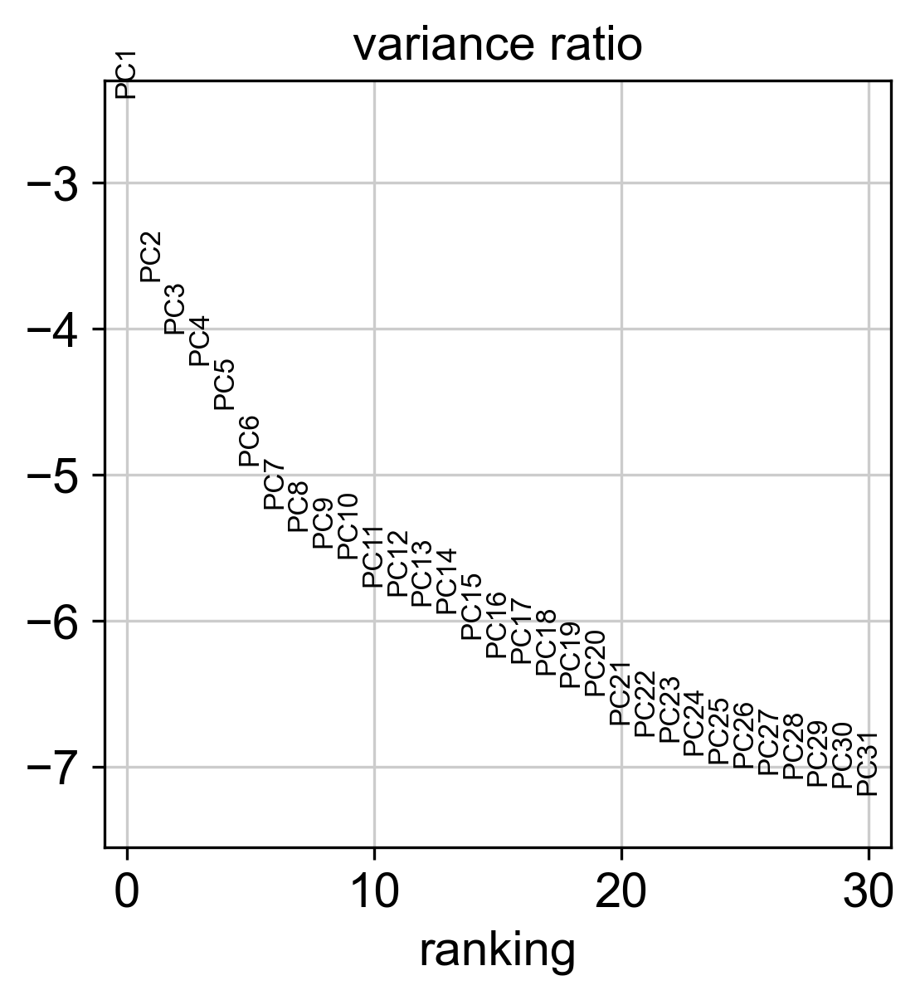

In [27]:
sc.pl.pca_variance_ratio(bdata_sig,log=True)

In [28]:
sc.pp.neighbors(bdata_sig,n_pcs=26)

In [29]:
sc.tl.umap(bdata_sig,n_components=2)

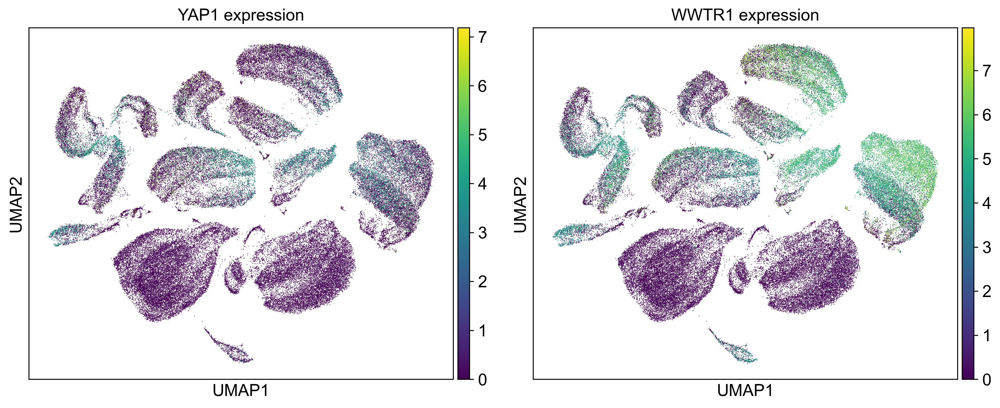

In [30]:
# 2. Visualizations
# Plot YAP1 and WWTR1 expression
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
sc.pl.umap(bdata_sig, color='YAP1', ax=ax1, show=False, title='YAP1 expression')
sc.pl.umap(bdata_sig, color='WWTR1', ax=ax2, show=False, title='WWTR1 expression')
plt.tight_layout()
plt.show()



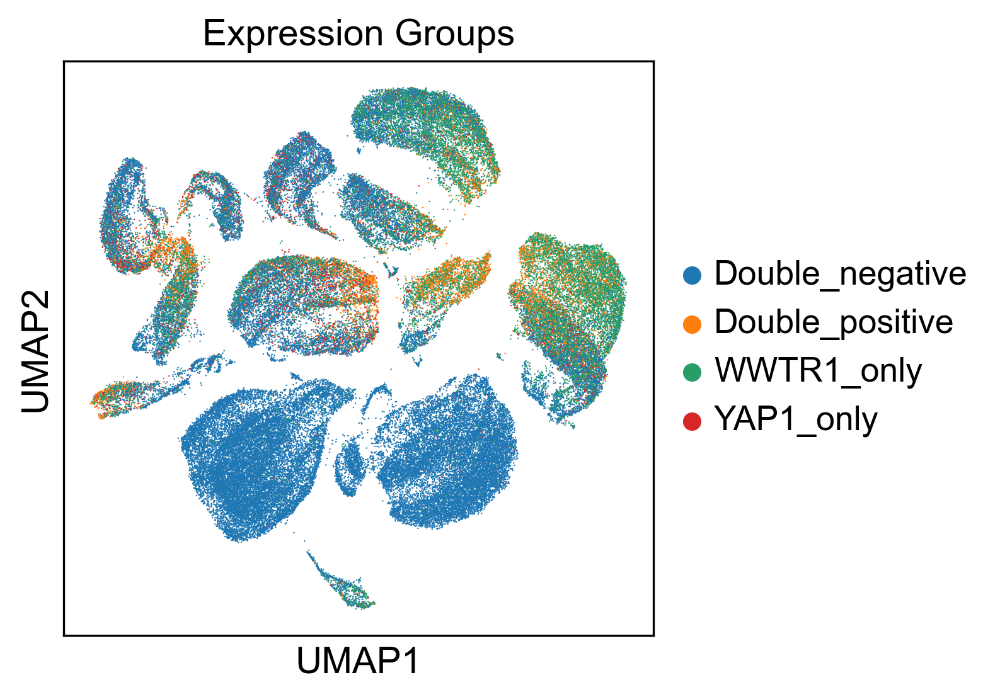

In [31]:
# Plot expression groups
sc.pl.umap(bdata_sig, color='expression_group', title='Expression Groups')



In [32]:
# 3. Cell type markers
cell_markers = {
    'Luminal': ['EPCAM', 'KRT8', 'KRT18'],
    'Basal': ['KRT5', 'KRT14'],
    'Myoepithelial': ['ACTA2', 'MYLK'],
    'Fibroblasts': ['COL1A1', 'DCN'],
    'Immune': ['PTPRC'],  # CD45
    'Endothelial': ['PECAM1']  # CD31
}



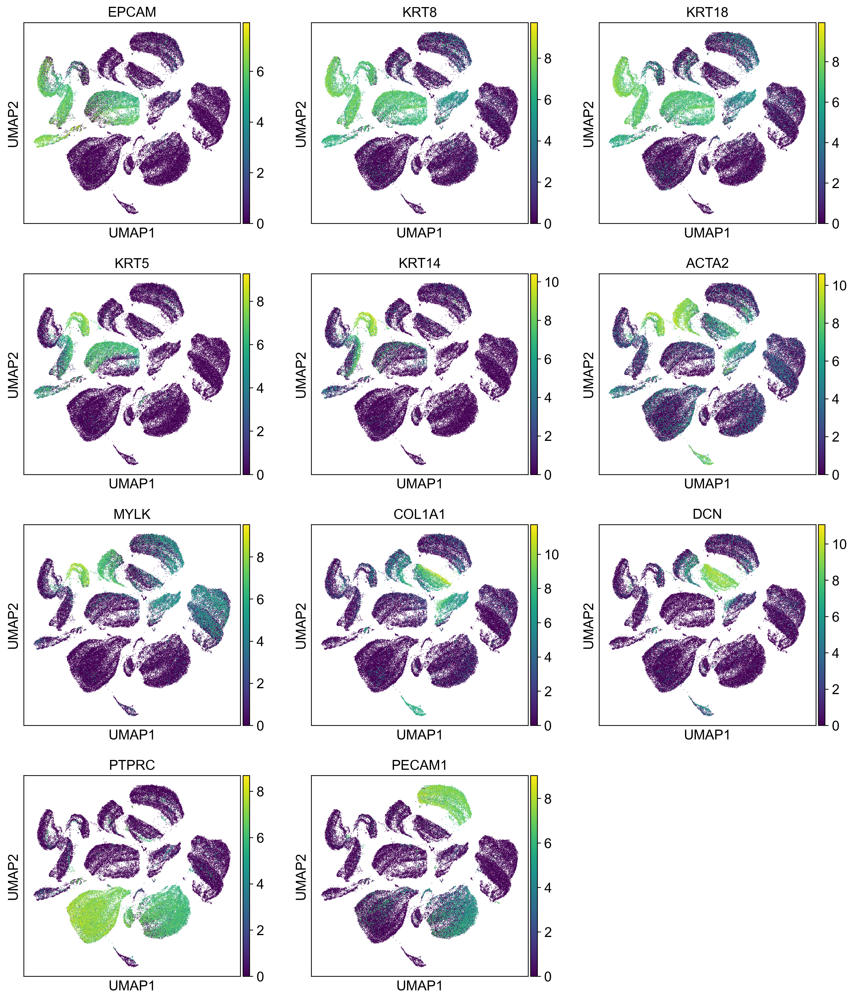

In [33]:
# Plot cell type markers
sc.pl.umap(bdata_sig, color=sum(cell_markers.values(), []), ncols=3)




In [66]:

group_percentages = bdata_sig.obs['expression_group'].value_counts(normalize=True) * 100
print("\nPercentage of cells in each expression group in sig:")
print(group_percentages)




Percentage of cells in each expression group in sig:
expression_group
Double_negative    63.238711
WWTR1_only         23.562425
Double_positive     8.308359
YAP1_only           4.890505
Name: proportion, dtype: float64


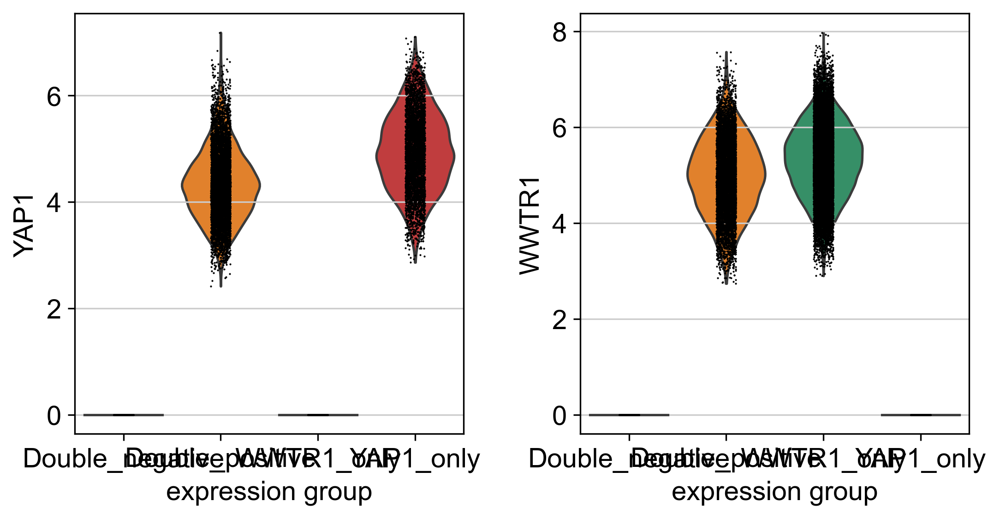

In [35]:
sc.pl.violin(bdata_sig, ['YAP1', 'WWTR1'], groupby='expression_group')



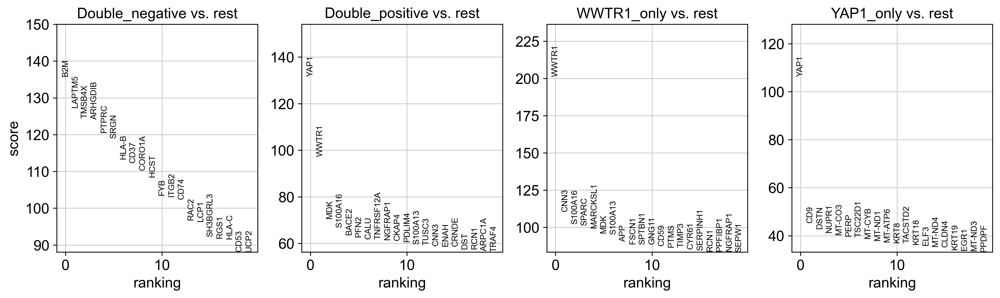

In [36]:
# 6. Analyze cell types within each expression group
# Get average expression of markers in each group
marker_genes = sum(cell_markers.values(), [])
sc.tl.rank_genes_groups(bdata_sig, 'expression_group', method='wilcoxon')
sc.pl.rank_genes_groups(bdata_sig, n_genes=20, sharey=False)

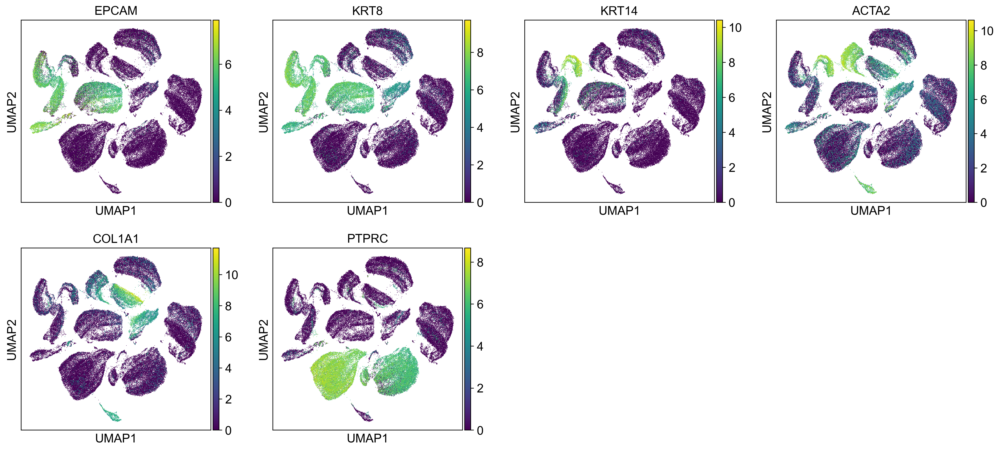

In [37]:
# Add this analysis
sc.pl.umap(bdata_sig, color=['EPCAM', 'KRT8', 'KRT14', 'ACTA2', 'COL1A1', 'PTPRC'])

In [38]:
print(bdata_sig.obs['expression_group'].value_counts(normalize=True) * 100)

expression_group
Double_negative    63.238711
WWTR1_only         23.562425
Double_positive     8.308359
YAP1_only           4.890505
Name: proportion, dtype: float64


In [39]:
bdata_ctr1=sc.read_h5ad('/Users/anuvindpramod/Desktop/code/Sc_RNA_seq /bdata_ctr1.h5ad')

In [40]:
bdata_ctr1.var_names_make_unique()
sc.pp.normalize_total(bdata_ctr1,target_sum=1e6)
sc.pp.log1p(bdata_ctr1)



In [55]:
yap1_exp_ctr1 = bdata_ctr1[:, 'YAP1'].X.toarray().flatten()
yap1_min_ctr1=yap1_exp_ctr1.min()
yap1_max_ctr1=yap1_exp_ctr1.max()
print(f"YAP1 expression range in ctr1: {yap1_min_ctr1} to {yap1_max_ctr1}")




YAP1 expression range in ctr1: 0.0 to 6.367923736572266


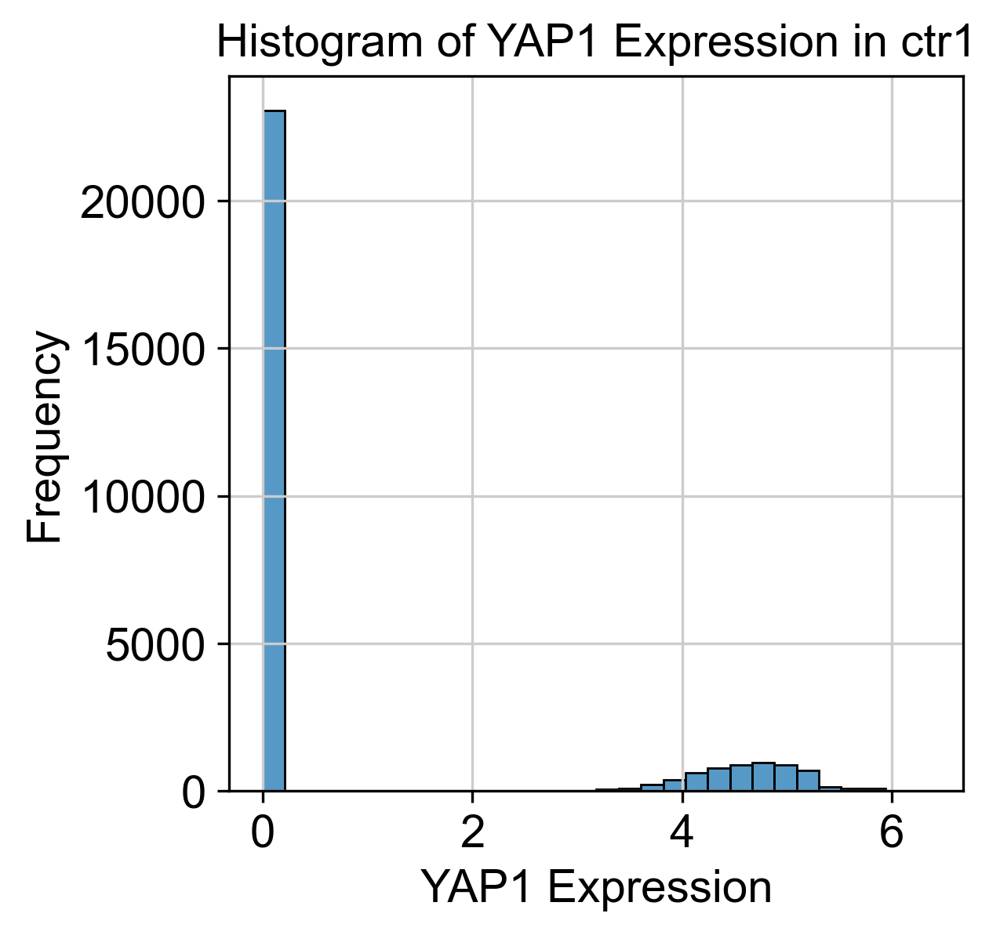

In [56]:
sns.histplot(yap1_exp_ctr1, bins=30, kde=False)
plt.title('Histogram of YAP1 Expression in ctr1')
plt.xlabel('YAP1 Expression')
plt.ylabel('Frequency')
plt.show()


In [57]:
wwtr1_exp_ctr1 = bdata_ctr1[:, 'WWTR1'].X.toarray().flatten()

#exp groups
bdata_ctr1.obs['expression_group'] = 'Double_negative'
bdata_ctr1.obs.loc[(yap1_exp_ctr1 > 0) & (wwtr1_exp_ctr1 == 0), 'expression_group'] = 'YAP1_only'
bdata_ctr1.obs.loc[(yap1_exp_ctr1 == 0) & (wwtr1_exp_ctr1 > 0), 'expression_group'] = 'WWTR1_only'
bdata_ctr1.obs.loc[(yap1_exp_ctr1 > 0) & (wwtr1_exp_ctr1 > 0), 'expression_group'] = 'Double_positive'


In [47]:
sc.tl.pca(bdata_ctr1,svd_solver='arpack')

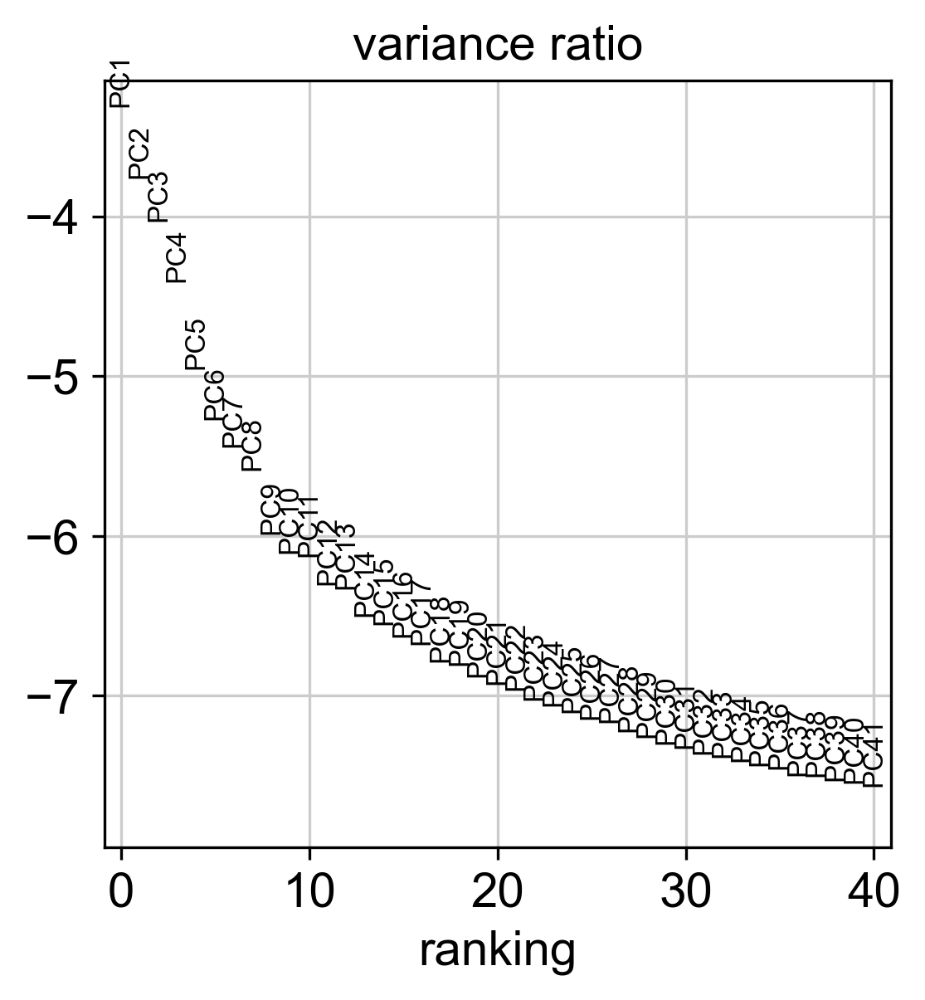

In [49]:
sc.pl.pca_variance_ratio(bdata_ctr1,log=True,n_pcs=40)

In [62]:
sc.pp.neighbors(bdata_ctr1,n_pcs=31)
sc.tl.umap(bdata_ctr1,n_components=2)




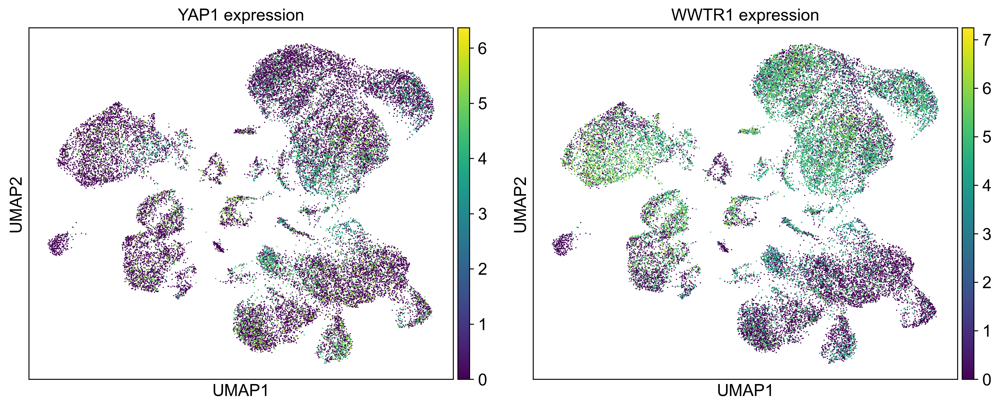

In [63]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
sc.pl.umap(bdata_ctr1, color='YAP1', ax=ax1, show=False, title='YAP1 expression')
sc.pl.umap(bdata_ctr1, color='WWTR1', ax=ax2, show=False, title='WWTR1 expression')
plt.tight_layout()
plt.show()


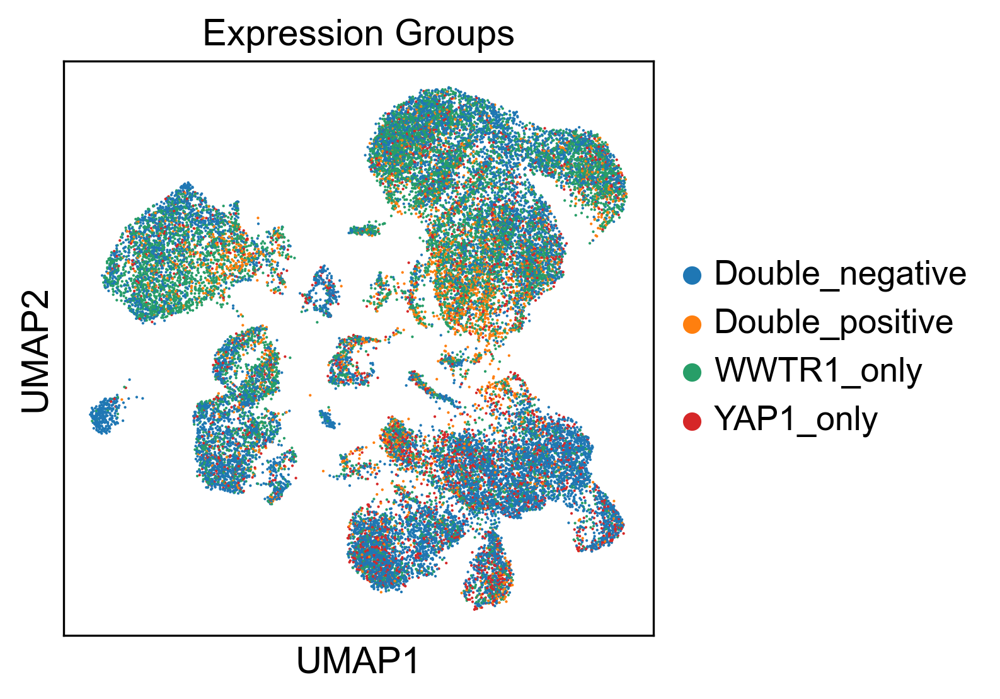

In [52]:
sc.pl.umap(bdata_ctr1, color='expression_group', title='Expression Groups')


In [58]:
pvalue=mannwhitneyu(yap1_exp_ctr1,yap1_exp_sig).pvalue
print(f"pvalue: {pvalue}")


pvalue: 2.570570283169251e-202


In [59]:
'There is a significant difference in YAP1 expression between the two groups'

'There is a significant difference in YAP1 expression between the two groups'

In [61]:
pvalue=mannwhitneyu(wwtr1_exp_ctr1,wwtr1_exp_sig).pvalue
print(f"pvalue: {pvalue}")

'There is a significant difference in WWTR1 expression between the two groups'

pvalue: 2.457582551767391e-100


'There is a significant difference in WWTR1 expression between the two groups'

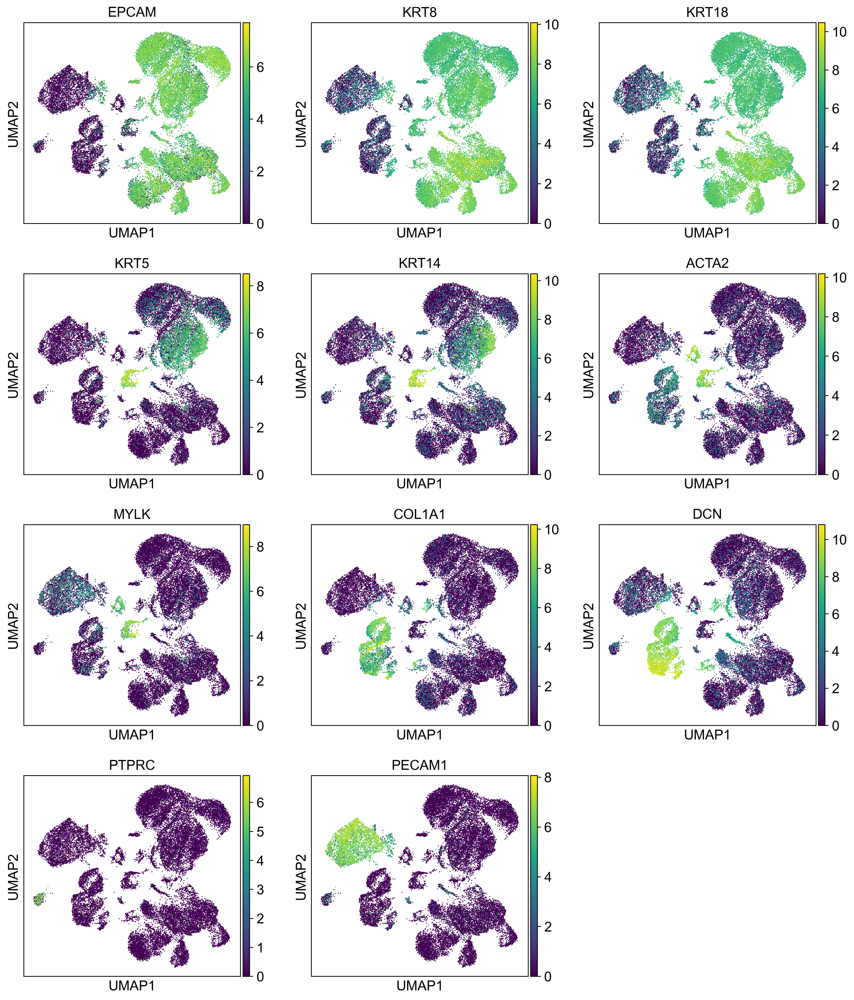

In [64]:
sc.pl.umap(bdata_ctr1,color=sum(cell_markers.values(),[]),ncols=3)

In [67]:
group_percentages = bdata_ctr1.obs['expression_group'].value_counts(normalize=True) * 100
print("\nPercentage of cells in each expression group in ctr1:")
print(group_percentages)



Percentage of cells in each expression group in ctr1:
expression_group
Double_negative    46.874137
WWTR1_only         32.802570
YAP1_only          10.586488
Double_positive     9.736806
Name: proportion, dtype: float64


In [ ]:
def preprocess_and_cluster():
    # Load the signal and control datasets
    # Replace 'path/to/signal_dataset.h5ad' and 'path/to/control_dataset.h5ad' with actual file paths
    signal = sc.read_h5ad('data/signal_dataset.h5ad')
    control = sc.read_h5ad('data/control_dataset.h5ad')
    
    # Concatenate the datasets
    adata = signal.concatenate(control, batch_key='condition', batch_categories=['signal', 'control'])
    
    # Normalize the data
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    
    # Select highly variable genes
    sc.pp.highly_variable_genes(adata, n_top_genes=2000, subset=True, flavor='seurat_v3')
    
    # Scale the data
    sc.pp.scale(adata, max_value=10)
    
    # Perform PCA
    sc.tl.pca(adata, svd_solver='arpack')
    
    # Compute the neighborhood graph
    sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)
    
    # Perform Leiden clustering
    sc.tl.leiden(adata, resolution=0.5)
    
    # Compute t-SNE
    sc.tl.tsne(adata, n_pcs=40)
    
    # Save the processed data
    adata.write('results/processed_data.h5ad')
    
    return adata

def analyze_gene_expression(adata, gene1='YAP1', gene2='WWTR1'):
    # Ensure the genes are in the dataset
    if gene1 not in adata.var_names or gene2 not in adata.var_names:
        raise ValueError(f"One of the genes {gene1} or {gene2} is not present in the dataset.")
    
    # Add binary expression for each gene
    adata.obs[f'{gene1}_expressed'] = adata[:, gene1].X > 0
    adata.obs[f'{gene2}_expressed'] = adata[:, gene2].X > 0
    
    # Calculate expression categories
    adata.obs['expression_category'] = 'Neither'
    adata.obs.loc[adata.obs[f'{gene1}_expressed'] & ~adata.obs[f'{gene2}_expressed'], 'expression_category'] = gene1
    adata.obs.loc[~adata.obs[f'{gene1}_expressed'] & adata.obs[f'{gene2}_expressed'], 'expression_category'] = gene2
    adata.obs.loc[adata.obs[f'{gene1}_expressed'] & adata.obs[f'{gene2}_expressed'], 'expression_category'] = 'Both'
    
    # Count the number of cells in each category
    counts = adata.obs['expression_category'].value_counts()
    print("Expression Counts:")
    print(counts)
    
    # Plotting the expression categories
    sc.pl.tsne(adata, color='expression_category', title='Gene Expression Categories', save='_expression_categories.png')
    
    return counts

def identify_cell_types(adata):
    # Assuming cell type annotations are available, otherwise perform marker-based annotation
    # Here we perform automated annotation using the scanpy function
    sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
    sc.pl.rank_genes_groups(adata, n_genes=25, save='_rank_genes.png')
    
    # Manual annotation would be needed based on known markers
    # For demonstration, we'll assign dummy cell types
    # Replace this with actual annotation logic
    adata.obs['cell_type'] = adata.obs['leiden'].astype(str)
    
    # Save the annotated data
    adata.write('results/annotated_data.h5ad')
    
    return adata.obs['cell_type'].value_counts()

def main():
    # Preprocess the data and perform clustering
    adata = preprocess_and_cluster()
    
    # Analyze gene expression for YAP1 and WWTR1
    expression_counts = analyze_gene_expression(adata, gene1='YAP1', gene2='WWTR1')
    
    # Identify and count cell types expressing the genes
    cell_type_counts = identify_cell_types(adata)
    
    # Save counts to a CSV file
    counts_df = pd.DataFrame({
        'Expression_Category': expression_counts.index,
        'Cell_Count': expression_counts.values
    })
    counts_df.to_csv('results/expression_counts.csv', index=False)
    
    cell_type_counts_df = cell_type_counts.reset_index()
    cell_type_counts_df.columns = ['Cell_Type', 'Count']
    cell_type_counts_df.to_csv('results/cell_type_counts.csv', index=False)
    
    print("Downstream analysis completed. Results saved in the 'results/' directory.")

if __name__ == "__main__":
    main()